In [1]:
import sys

sys.path.append("../src")

import numpy as np
import librosa
import matplotlib.pyplot as plt
import torch
import IPython.display as ipd
import soundfile as sf

from net.vim import VisionMamba
from utils.make_eqs import running_mean

In [2]:
ckpt_path = "../logs/gtzan_vision-mam_lr=1e-4_fp32/v0/fit1/checkpoints/best-epoch=101-val_loss=0.1184.ckpt"
ckpt = torch.load(ckpt_path, map_location="cpu")
net = VisionMamba(img_size=(1025, 130), channels=1, num_classes=1025, embed_dim=192)
weights = {k[4:]: v for k, v in ckpt["state_dict"].items()}
net.load_state_dict(weights)

<All keys matched successfully>

In [5]:
wav, sr = librosa.load("../data/viviz.mp3", sr=22050)
print(wav.shape, sr)
ipd.display(ipd.Audio(wav, rate=sr))
trunc_wav = wav[sr * 40 : sr * 60]
# trunc_wav = wav
ipd.display(ipd.Audio(trunc_wav, rate=sr))

/tmp/ipykernel_611665/2668383346.py:1: UserWarning: PySoundFile failed. Trying audioread instead.
  wav, sr = librosa.load("../data/viviz.mp3", sr=22050)
[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.
/home/user/.pyenv/versions/audio-env/lib/python3.9/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


(4842496,) 22050


(1025,)


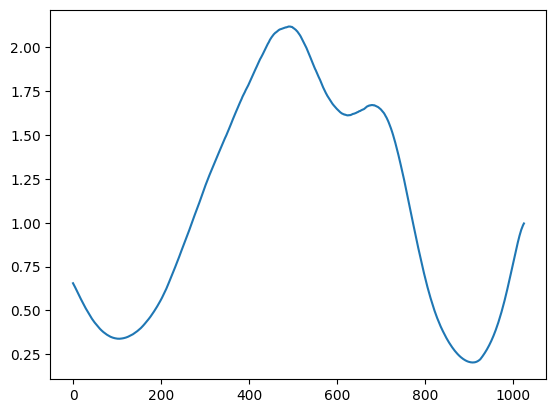

In [20]:
net = net.cuda()
spec = librosa.stft(trunc_wav[sr * 5 : sr * 8])
magspec = np.abs(spec).astype(np.float32)
magspec = torch.tensor(magspec).cuda() ** 0.3
eq = net(magspec[None, None, ...])
eq = eq[0].detach().cpu().numpy()
eq = running_mean(eq, 100)
eq = np.power(10, eq)
print(eq.shape)
plt.plot(eq)
# plt.xscale("log")
plt.show()

In [21]:
trunc_spec = librosa.stft(trunc_wav)
restore_spec = eq[:, None] * trunc_spec
restore_wav = librosa.istft(restore_spec)
ipd.display(ipd.Audio(restore_wav, rate=sr))
restore_wav = librosa.util.normalize(restore_wav)
sf.write("restore.wav", restore_wav, sr)
orig_wav = librosa.util.normalize(trunc_wav)
sf.write("orig.wav", orig_wav, sr)

In [17]:
full_spec = librosa.stft(wav)
restore_spec = eq[:, None] * full_spec
restore_wav = librosa.istft(restore_spec)
ipd.display(ipd.Audio(restore_wav, rate=sr))
restore_wav = librosa.util.normalize(restore_wav)
sf.write("restore.wav", restore_wav, sr)
orig_wav = librosa.util.normalize(trunc_wav)
sf.write("orig.wav", orig_wav, sr)